# Learning Grounded SAM for 3D point clouds
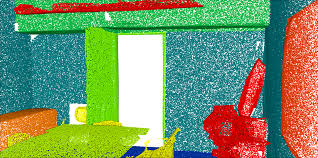


https://medium.com/data-science/segment-anything-3d-for-point-clouds-complete-guide-sam-3d-80c06be99a18

## Importing Libraries

In [1]:
# Base Libraries
import numpy as np
import matplotlib.pyplot as plt
import cv2
import laspy

# Deep Learning Libraries
import torch
from segment_anything import sam_model_registry
from segment_anything import SamAutomaticMaskGenerator

/home/cmgira/anaconda3/envs/PCSv1/lib/python3.10/site-packages/requests/__init__.py:86: RequestsDependencyWarning: Unable to find acceptable character detection dependency (chardet or charset_normalizer).
  warnings.warn(


## Checking Torch

In [2]:
print('CUDA available: ', torch.cuda.is_available())
print('CUDA GPU Number: ', torch.cuda.device_count())
print('GPU: ', torch.cuda.get_device_name())

CUDA available:  True
CUDA GPU Number:  1
GPU:  NVIDIA GeForce GTX 1080


## Initializing Model

In [5]:
MODEL = r"model/sam_vit_h_4b8939.pth"

USED_D = torch.device('cuda:0')

sam = sam_model_registry["vit_h"](checkpoint = MODEL)
sam.to(device="cuda")

Sam(
  (image_encoder): ImageEncoderViT(
    (patch_embed): PatchEmbed(
      (proj): Conv2d(3, 1280, kernel_size=(16, 16), stride=(16, 16))
    )
    (blocks): ModuleList(
      (0-31): 32 x Block(
        (norm1): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (attn): Attention(
          (qkv): Linear(in_features=1280, out_features=3840, bias=True)
          (proj): Linear(in_features=1280, out_features=1280, bias=True)
        )
        (norm2): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (mlp): MLPBlock(
          (lin1): Linear(in_features=1280, out_features=5120, bias=True)
          (lin2): Linear(in_features=5120, out_features=1280, bias=True)
          (act): GELU(approximate='none')
        )
      )
    )
    (neck): Sequential(
      (0): Conv2d(1280, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (1): LayerNorm2d()
      (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (3): LayerNorm2d

## Starting with 2D Projections
- Eventually, a 3D cloud point will have to be projected onto a 2D image, so it's good to understand what's happening here.

In [9]:
import os
print(os.getcwd())
path = r"DATA\biscarosse.jpg"
loaded_img = cv2.imread(path)
image_rgb = cv2.cvtColor(loaded_img, cv2.COLOR_BGR2RGB)

mask_generator = SamAutomaticMaskGenerator(sam)
result = mask_generator.generate(image_rgb)


c:\Users\caleb\CNEFS_Research\PCSv1\tutorials\sa3d


## Plotting masks on top of the image

In [10]:
def sam_masks(anns):
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)
    c_mask=[]
    for ann in sorted_anns:
        m = ann['segmentation']
        img = np.ones((m.shape[0], m.shape[1], 3))
        color_mask = np.random.random((1, 3)).tolist()[0]
        for i in range(3):
            img[:,:,i] = color_mask[i]
        ax.imshow(np.dstack((img, m*0.8)))
        c_mask.append(img)
    return c_mask


In [11]:
print('Mem allocated by other programs: ', torch.cuda.memory_allocated(), 'reserved:', torch.cuda.memory_reserved())
import os
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "max_split_size_mb:512"
import gc
gc.collect()
torch.cuda.empty_cache()

mask_generator = SamAutomaticMaskGenerator(sam, points_per_batch=16)
sam.to("cuda")

Mem allocated by other programs:  580146176 reserved: 9170845696


Sam(
  (image_encoder): ImageEncoderViT(
    (patch_embed): PatchEmbed(
      (proj): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
    )
    (blocks): ModuleList(
      (0-11): 12 x Block(
        (norm1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (attn): Attention(
          (qkv): Linear(in_features=768, out_features=2304, bias=True)
          (proj): Linear(in_features=768, out_features=768, bias=True)
        )
        (norm2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (mlp): MLPBlock(
          (lin1): Linear(in_features=768, out_features=3072, bias=True)
          (lin2): Linear(in_features=3072, out_features=768, bias=True)
          (act): GELU(approximate='none')
        )
      )
    )
    (neck): Sequential(
      (0): Conv2d(768, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (1): LayerNorm2d()
      (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (3): LayerNorm2d()
    )


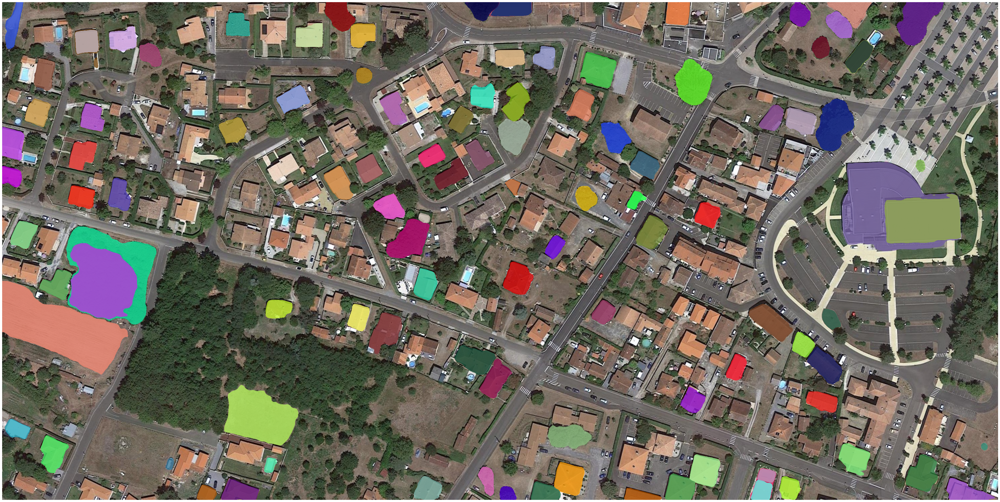

In [12]:
fig = plt.figure(figsize=(np.shape(image_rgb)[1]/72, np.shape(image_rgb)[0]/72))
fig.add_axes([0,0,1,1])
plt.imshow(image_rgb)
color_mask = sam_masks(result)
plt.axis('off')
plt.savefig("../test_result.jpg")

## Translating from Cloud Point to Image

In [13]:
def cloud_to_image(pcd_np, resolution):
    minx = np.min(pcd_np[:, 0])
    maxx = np.max(pcd_np[:, 0])
    miny = np.min(pcd_np[:, 1])
    maxy = np.max(pcd_np[:, 1])
    width = int((maxx - minx) / resolution) + 1
    height = int((maxy - miny) / resolution) + 1
    image = np.zeros((height, width, 3), dtype=np.uint8)
    for point in pcd_np:
        x, y, *_ = point
        r, g, b = point[-3:]
        pixel_x = int((x - minx) / resolution)
        pixel_y = int((maxy - y) / resolution)
        image[pixel_y, pixel_x] = [r, g, b]
    return image

## Point Cloud Spherical Projection

In [10]:
def generate_spherical_image(center_coordinates, point_cloud, colors, resolution_y=500):
    # Translate the point cloud by the negation of the center coordinates
    translated_points = point_cloud - center_coordinates

    # Convert 3D point cloud to spherical coordinates
    theta = np.arctan2(translated_points[:, 1], translated_points[:, 0])
    phi = np.arccos(translated_points[:, 2] / np.linalg.norm(translated_points, axis=1))

    # Map spherical coordinates to pixel coordinates
    x = (theta + np.pi) / (2 * np.pi) * (2 * resolution_y)
    y = phi / np.pi * resolution_y

     # Create the spherical image with RGB channels
    resolution_x = 2 * resolution_y
    image = np.zeros((resolution_y, resolution_x, 3), dtype=np.uint8)

    # Create the mapping between point cloud and image coordinates
    mapping = np.full((resolution_y, resolution_x), -1, dtype=int)

    # Assign points to the image pixels
    for i in range(len(translated_points)):
        ix = np.clip(int(x[i]), 0, resolution_x - 1)
        iy = np.clip(int(y[i]), 0, resolution_y - 1)
        if mapping[iy, ix] == -1 or np.linalg.norm(translated_points[i]) < np.linalg.norm(translated_points[mapping[iy, ix]]):
            mapping[iy, ix] = i
            image[iy, ix] = colors[i]
    return image, mapping

## Reading in Point Cloud Data

In [14]:
# Loading the las file from the disk
las = laspy.read("input_lidar/boardroom.las")

# Transforming to a numpy array
coords = np.vstack((las.x, las.y, las.z))
point_cloud = coords.transpose()

# --- Replacement Grayscale Code Block ---

# 1. Get the intensity values for each point
intensity_values = las.intensity

# 2. Normalize the intensity to a 0-1 range
min_i, max_i = np.min(intensity_values), np.max(intensity_values)
normalized_i = (intensity_values - min_i) / (max_i - min_i)

# 3. Scale the normalized values to the 0-255 grayscale range
gray_colors = (normalized_i * 255).astype(np.uint8)

# 4. Create the final (N, 3) colors array
colors = np.vstack((gray_colors, gray_colors, gray_colors)).transpose()

/tmp/ipykernel_32403/3812416402.py:15: RuntimeWarning: invalid value encountered in divide
  normalized_i = (intensity_values - min_i) / (max_i - min_i)
/tmp/ipykernel_32403/3812416402.py:18: RuntimeWarning: invalid value encountered in cast
  gray_colors = (normalized_i * 255).astype(np.uint8)


## Setting Parameters, generating image

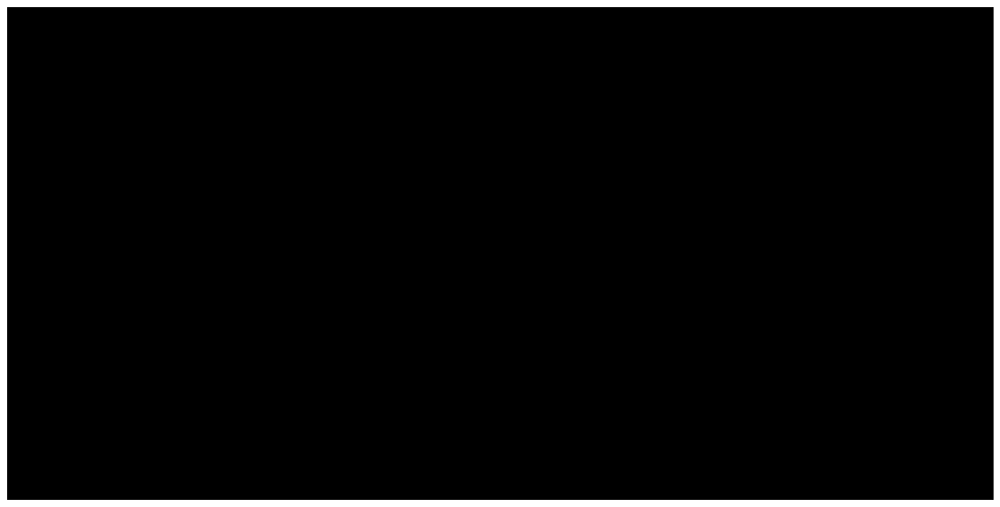

In [15]:
resolution = 500

center_coordinates = [189, 60, 2]

#Function Execution
spherical_image, mapping = generate_spherical_image(center_coordinates, point_cloud, colors, resolution)

#Plotting with matplotlib
fig = plt.figure(figsize=(np.shape(spherical_image)[1]/72, np.shape(spherical_image)[0]/72))
fig.add_axes([0,0,1,1])
plt.imshow(spherical_image)
plt.axis('off')

#Saving to the disk
plt.savefig("input_images/boardroom_spherical.jpg")

## SAM Segmentation of Spherical Projection
Process is quite similar, minimal differences

In [26]:
MODEL = MODEL = r"MODEL\sam_vit_h_4b8939.pth"

sam = sam_model_registry["vit_h"](checkpoint = MODEL)
sam.to(device="cuda")

mask_generator = SamAutomaticMaskGenerator(sam)

temp_img = cv2.imread("DATA/ITC_BUILDING_spherical_projection.jpg")
image_rgb = cv2.cvtColor(temp_img, cv2.COLOR_BGR2RGB)

import time
t0 = time.time()
result = mask_generator.generate(image_rgb)
t1 = time.time()

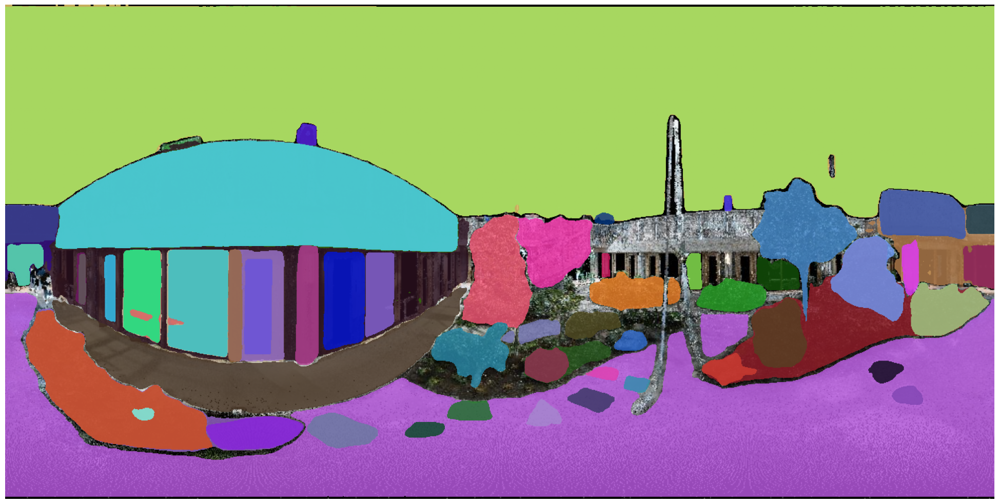

In [27]:
fig = plt.figure(figsize=(np.shape(image_rgb)[1]/72, np.shape(image_rgb)[0]/72))
fig.add_axes([0,0,1,1])

plt.imshow(image_rgb)
color_mask = sam_masks(result)
plt.axis('off')
plt.savefig("DATA/ITC_BUILDING_spherical_projection_segmented.jpg")